In [5]:
!pip install facenet_pytorch
from facenet_pytorch import MTCNN
import cv2
from PIL import Image as Img
from PIL import ImageTk
import numpy as np
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import os


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 9.7 MB/s eta 0:00:00


In [6]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [100]:
# Mặc định threshold = [0.6, 0.7, 0.7]
mtcnn = MTCNN(margin=20, keep_all=True, post_process=False, device='cpu')

In [ ]:
# Đường dẫn mới bạn muốn tạo thư mục
save_images_url = r'/content/drive/MyDrive/Facenet_khaiphadulieu/dataset/clean_data/'
person = video_url.split('.')[0].split('/')[-1]

# print(len(frames))
# print(len(faces))

new_directory_path = f'{save_images_url}{person}'

# Kiểm tra nếu thư mục chưa tồn tại
if not os.path.exists(new_directory_path):
    # Tạo thư mục mới
    os.makedirs(new_directory_path)
else:
  print('Loi tao thu muc')

save_paths = [f'{save_images_url}{person}/image_{i}.jpg' for i in range(len(frames))]
print(len(save_paths))
batch_size = 20
index = 0

for i in tqdm(range(int(len(frames)))):
  mtcnn(frames[i:i+1], save_paths[i: i + 1])
  # print(face.shape)
  # if((i+1) % 20 ==0 or i == len(frames) - 1 ):
    # mtcnn(frames[index * 20: i], save_paths[index * 20: i])
    # index += 1

# vantien591

200


  0%|          | 0/200 [00:00<?, ?it/s]

Quá trình tiền xử lý hình ảnh đã hoàn tất, tiếp theo ta sẽ sử dụng mô hình facenet để tiến hành mã hóa các hình ảnh thành các vector tương ứng.

In [8]:
import glob
import torch
from torchvision import transforms
from facenet_pytorch import InceptionResnetV1, fixed_image_standardization
import os
from PIL import Image
import numpy as np

In [9]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

cuda:0


In [10]:
def trans(img):
    transform = transforms.Compose([
            transforms.ToTensor(),
            fixed_image_standardization
        ])
    return transform(img)

In [11]:
def fixed_image_standardization(image_tensor):
    processed_tensor = (image_tensor - 127.5) / 128.0
    return processed_tensor

In [12]:
model = InceptionResnetV1(
    classify=False,
    pretrained="casia-webface"
).to(device)

model.eval()

  0%|          | 0.00/111M [00:00<?, ?B/s]

InceptionResnetV1(
  (conv2d_1a): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_2a): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_2b): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (maxpool_3a): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2d_3b): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU()
  )
  (conv2d_4a): 

In [203]:
IMG_PATH = '/content/drive/MyDrive/Facenet_khaiphadulieu/dataset/clean_data'

embeddings = []
names = []

for usr in os.listdir(IMG_PATH):
  embeds = []
  for file in tqdm(glob.glob(os.path.join(IMG_PATH, usr)+'/*.jpg')):
      try:
          img = Image.open(file)
          # RGB, 160x160
      except:
          continue

      with torch.no_grad():
          embed = model(trans(img).unsqueeze(0).to(device))
          embeds.append(embed.unsqueeze(0)) #1 anh, kich thuoc [1,512]

  if len(embeds) == 0:
    continue

  embedding = torch.cat(embeds).mean(0, keepdim=True) #dua ra trung binh cua cac tensor, kich thuoc [1,512]
  embeddings.append(embedding) # 1 cai list n cai [1,512]
  names.append(usr)

print(len(embeddings))
print(names)

  0%|          | 0/575 [00:00<?, ?it/s]

  0%|          | 0/65 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/353 [00:00<?, ?it/s]

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/565 [00:00<?, ?it/s]

  0%|          | 0/589 [00:00<?, ?it/s]

  0%|          | 0/235 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/627 [00:00<?, ?it/s]

  0%|          | 0/585 [00:00<?, ?it/s]

  0%|          | 0/474 [00:00<?, ?it/s]

  0%|          | 0/362 [00:00<?, ?it/s]

  0%|          | 0/576 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

17
['TienNhat', 'ThuThao', 'VanTien585', 'DatVan', 'MongDo', 'NhatPhuong', 'HoaiNam', 'QuangHuy', 'TuanPhong', 'CongLuong', 'KhanhDuong', 'KyNam', 'NguyenBao', 'PhucDuy', 'TuanAnh', 'CongSon', 'VanTien591']


In [204]:
face_embedding_path = '/content/drive/MyDrive/Facenet_khaiphadulieu/dataset/face_embedding_2'

In [205]:
# Tìm Hiểu
print(len(embeddings))
embeddings_next = torch.cat(embeddings) #[n,512]
embeddings_final = torch.squeeze(embeddings_next, dim=1)
names = np.array(names)
torch.save(embeddings_final, face_embedding_path+"/faceslist.pth")
np.save(face_embedding_path+"/usernames", names)


17


In [206]:
def load_faceslist():
    embeds = torch.load(face_embedding_path + '/faceslist.pth')
    names = np.load(face_embedding_path+'/usernames.npy')
    return embeds, names

embeddings, names = load_faceslist()
print(embeddings.shape)
print(names)

torch.Size([17, 512])
['TienNhat' 'ThuThao' 'VanTien585' 'DatVan' 'MongDo' 'NhatPhuong'
 'HoaiNam' 'QuangHuy' 'TuanPhong' 'CongLuong' 'KhanhDuong' 'KyNam'
 'NguyenBao' 'PhucDuy' 'TuanAnh' 'CongSon' 'VanTien591']


In [157]:
# Tìm Hiểu
def extract_face(box, img, margin=20):
    face_size = 160
    img_size = img.shape[:2]
    margin = [
        margin * (box[2] - box[0]) / (face_size - margin),
        margin * (box[3] - box[1]) / (face_size - margin),
    ]

    box = [ #box[0] và box[1] là tọa độ của điểm góc trên cùng trái
        int(max(box[0] - margin[0] / 2, 0)), #nếu thêm vào margin bị ra khỏi rìa ảnh => đưa về điểm 0
        int(max(box[1] - margin[1] / 2, 0)),
        int(min(box[2] + margin[0] / 2, img_size[0])), #nếu thêm vào margin bị ra khỏi rìa ảnh => đưa về tọa độ của ảnh gốc
        int(min(box[3] + margin[1] / 2, img_size[1])),

    ] #tạo margin mới bao quanh box cũ
    img = img[box[1]:box[3], box[0]:box[2]]
    face = cv2.resize(img,(face_size, face_size), interpolation=cv2.INTER_AREA)
    face = Img.fromarray(face)
    return face


In [186]:
def inference(model, face, local_embeds, power, threshold = 0.7):
    #local: [n,512] voi n la so nguoi trong faceslist
    embeds = []
    embed = model(trans(face).unsqueeze(0).to(device))
    embeds.append(embed.unsqueeze(0))
    detect_embeds = torch.cat(embeds)
    norm_diff = torch.transpose(detect_embeds, 1, 2) - torch.transpose(local_embeds, 0, 1).unsqueeze(0)
    norm_score = torch.sum(torch.pow(norm_diff, 2), dim=1) #(1,n), moi cot la tong khoang cach euclide so vs embed moi
    min_dist, embed_idx = torch.min(norm_score, dim = 1)
    print(embed_idx)
    print(min_dist*power, names[embed_idx])
    if min_dist*power > threshold:
        return -1, -1
    else:
        return embed_idx, min_dist.double()

tensor([15], device='cuda:0')
tensor([0.4788], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.47878421582936426


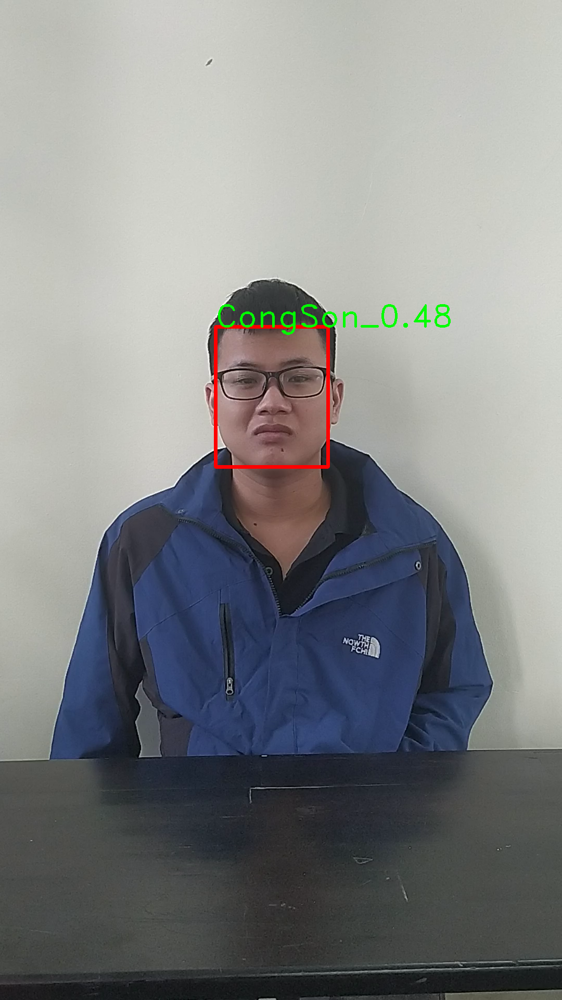

tensor([13], device='cuda:0')
tensor([0.3157], device='cuda:0', grad_fn=<MulBackward0>) PhucDuy
0.31569248903906555


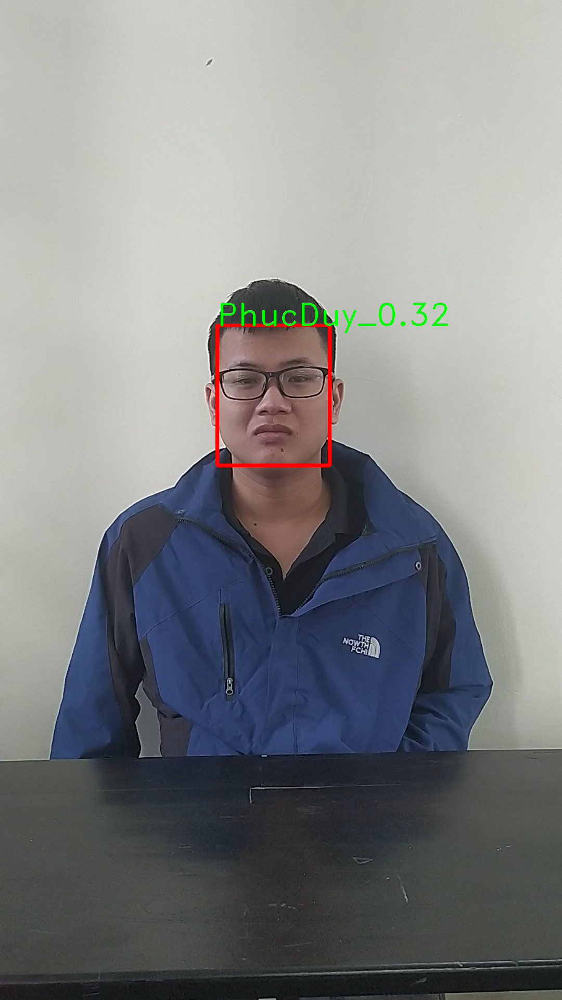

tensor([15], device='cuda:0')
tensor([0.3591], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.3590606638681493


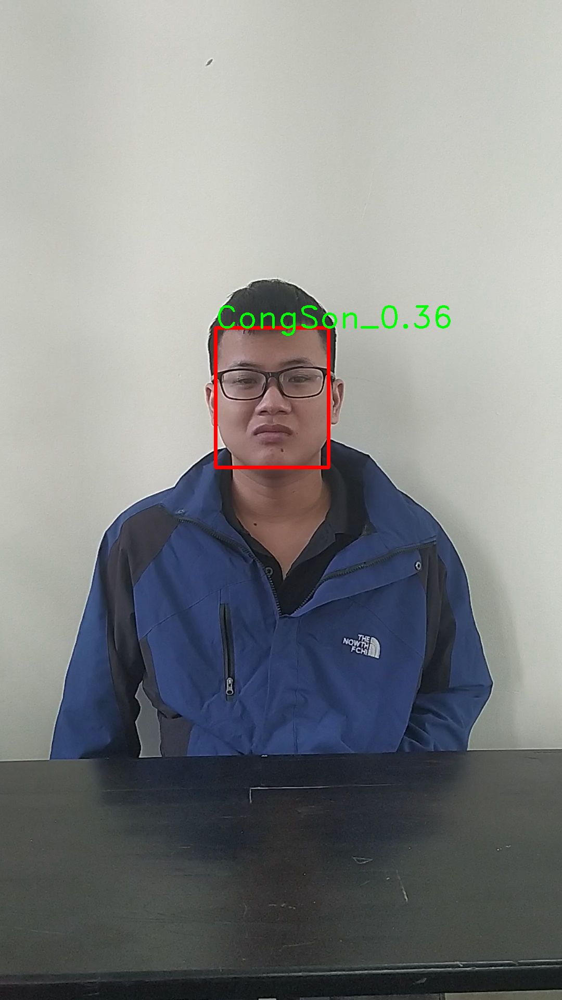

tensor([6], device='cuda:0')
tensor([0.3795], device='cuda:0', grad_fn=<MulBackward0>) HoaiNam
0.3794813494550908


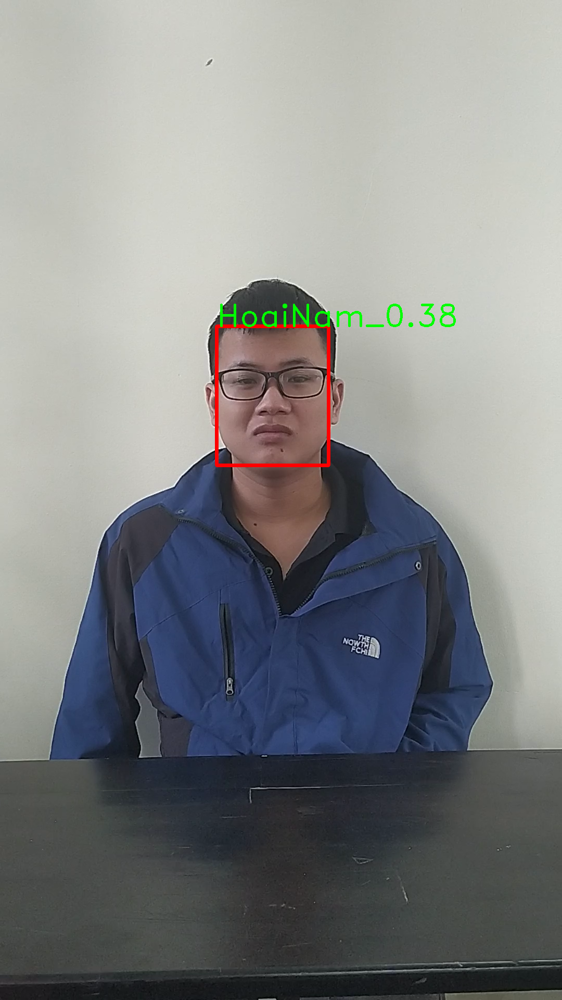

tensor([15], device='cuda:0')
tensor([0.2720], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.27200650265513104


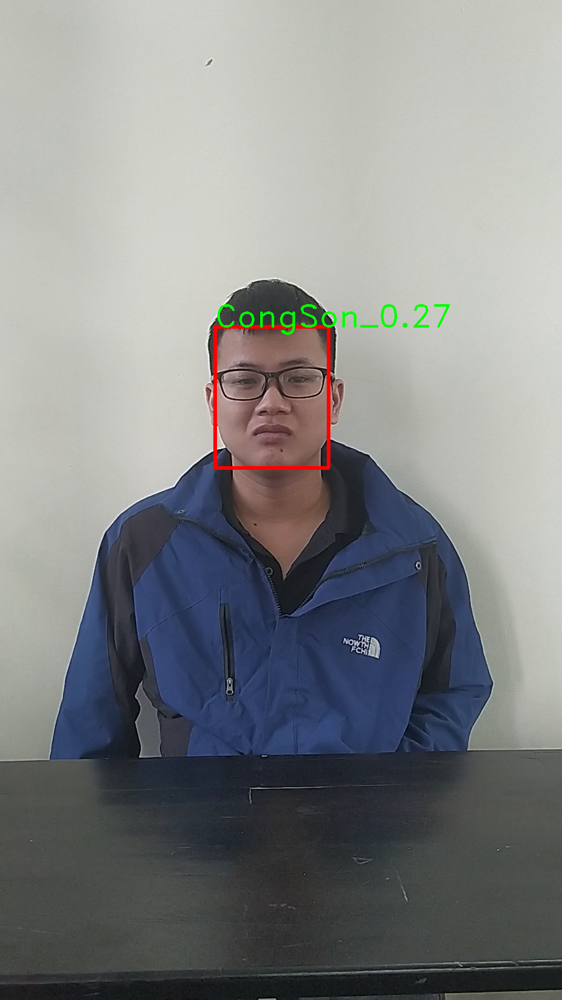

tensor([15], device='cuda:0')
tensor([0.2673], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.26731146363090375


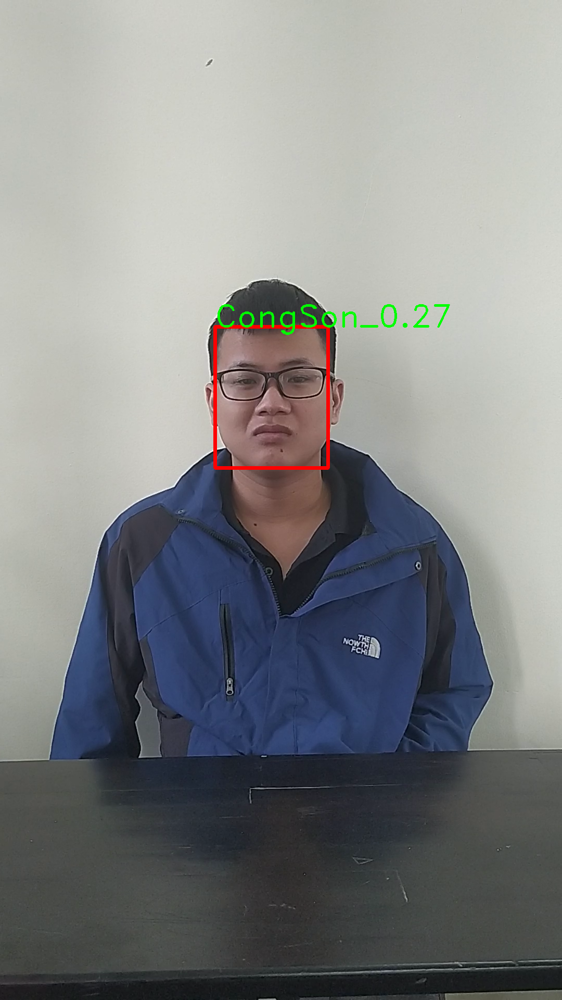

tensor([13], device='cuda:0')
tensor([0.7110], device='cuda:0', grad_fn=<MulBackward0>) PhucDuy


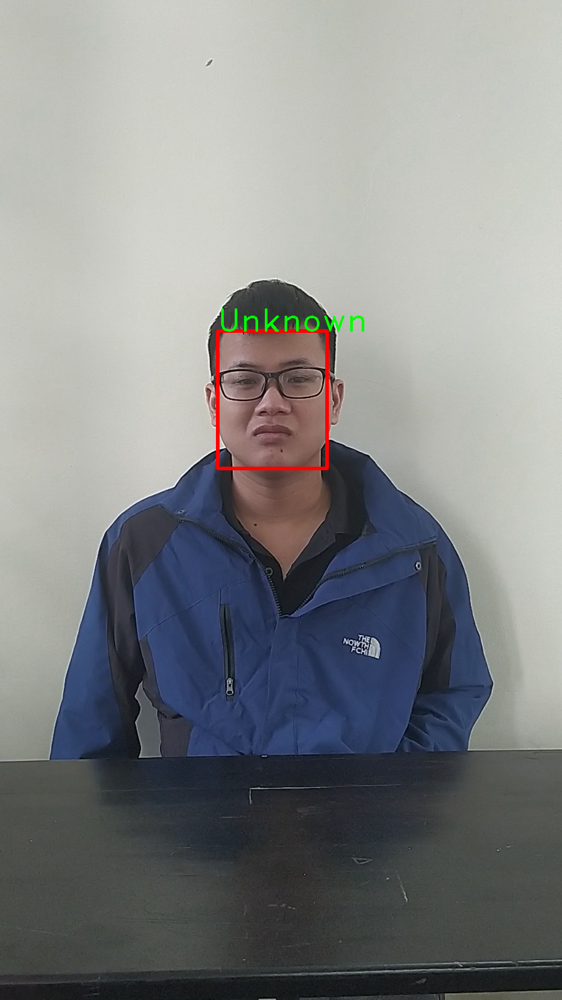

tensor([16], device='cuda:0')
tensor([0.7991], device='cuda:0', grad_fn=<MulBackward0>) VanTien591


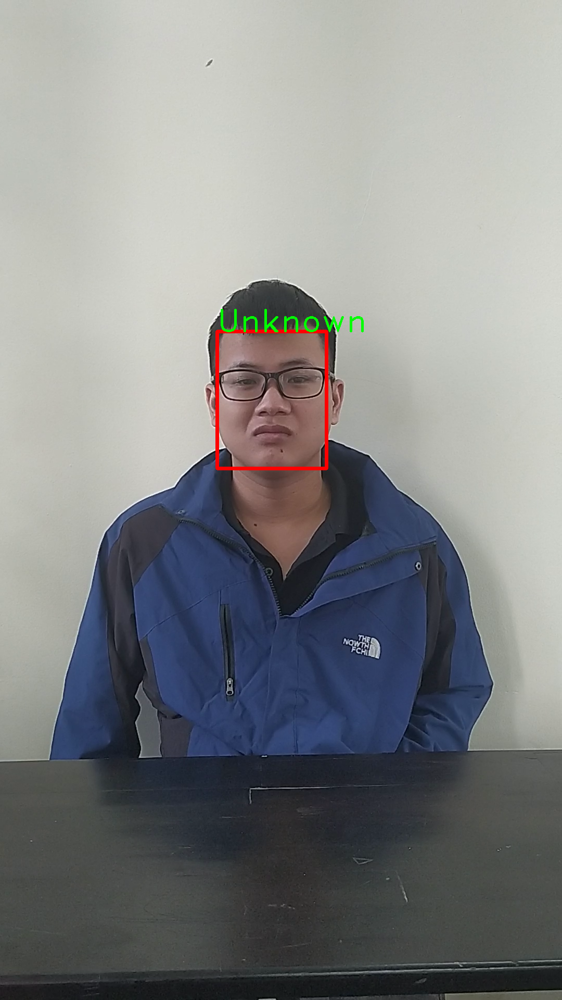

tensor([15], device='cuda:0')
tensor([0.7573], device='cuda:0', grad_fn=<MulBackward0>) CongSon


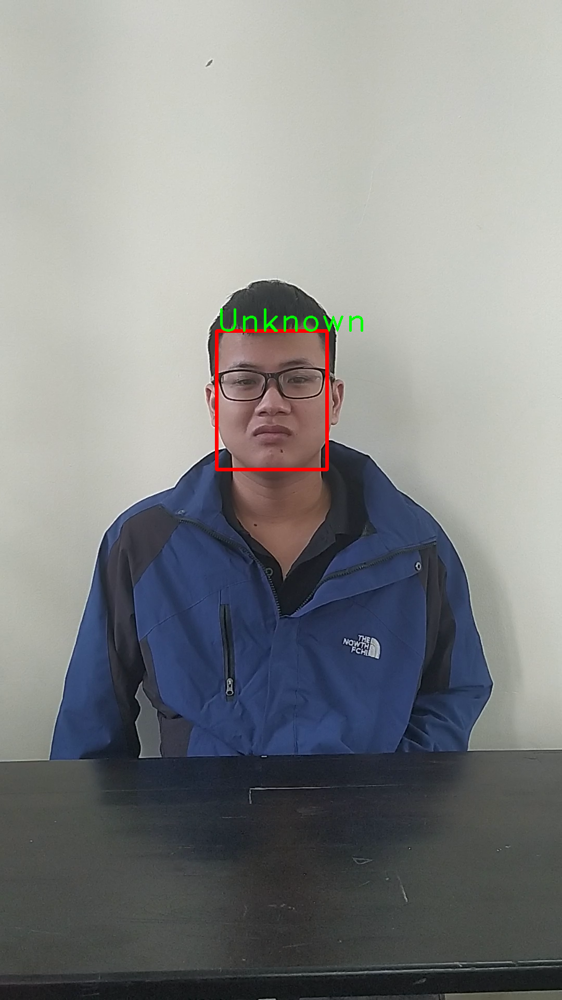

tensor([15], device='cuda:0')
tensor([0.0568], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.05676417913491605


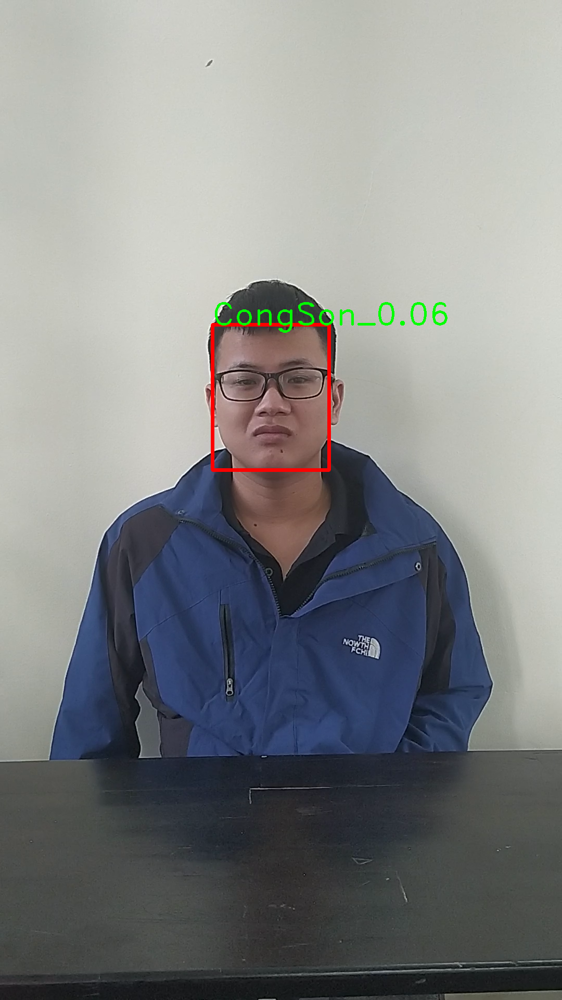

tensor([15], device='cuda:0')
tensor([0.0509], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.05088473642445024


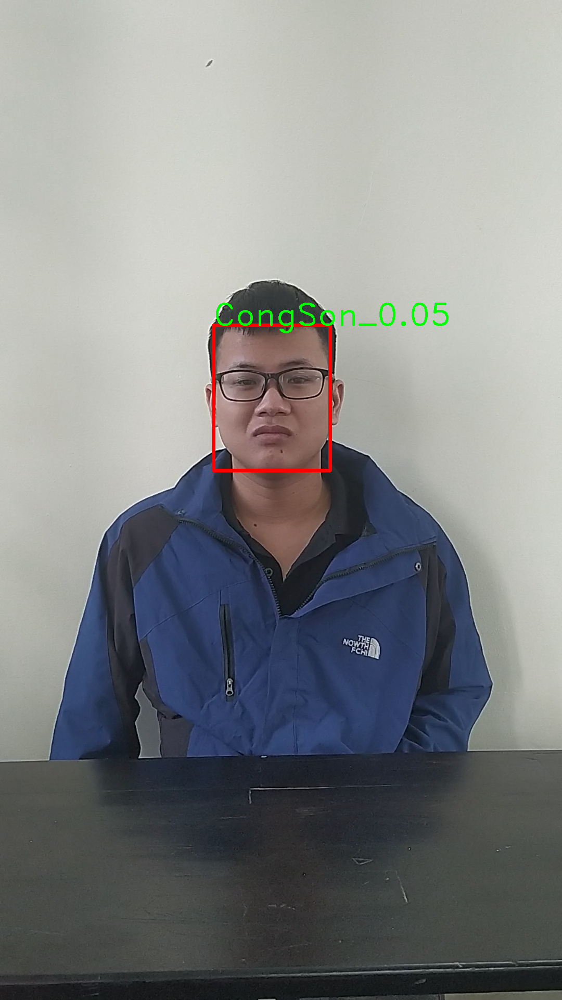

tensor([15], device='cuda:0')
tensor([0.1017], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.10173540232472078


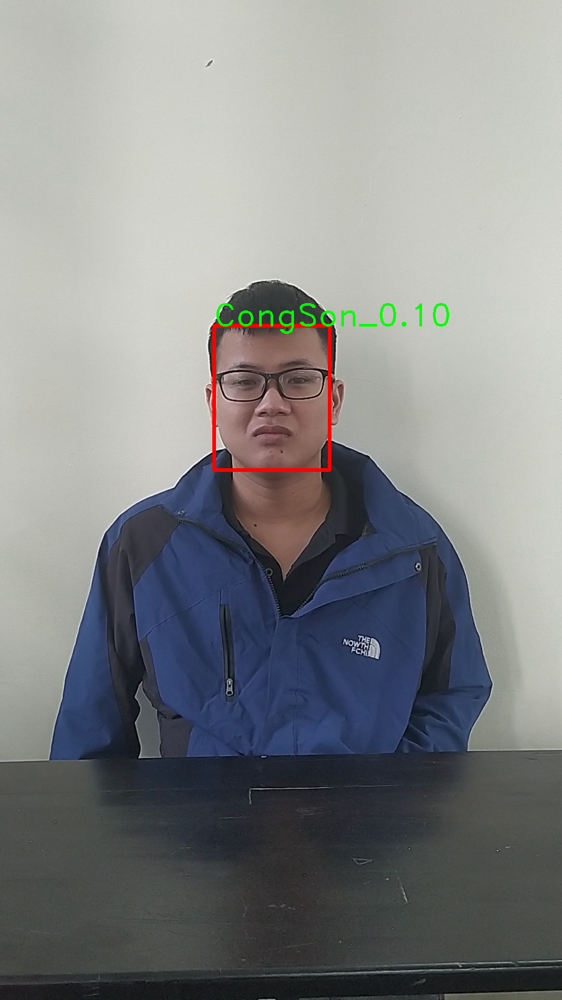

tensor([15], device='cuda:0')
tensor([0.0892], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.0891735112418246


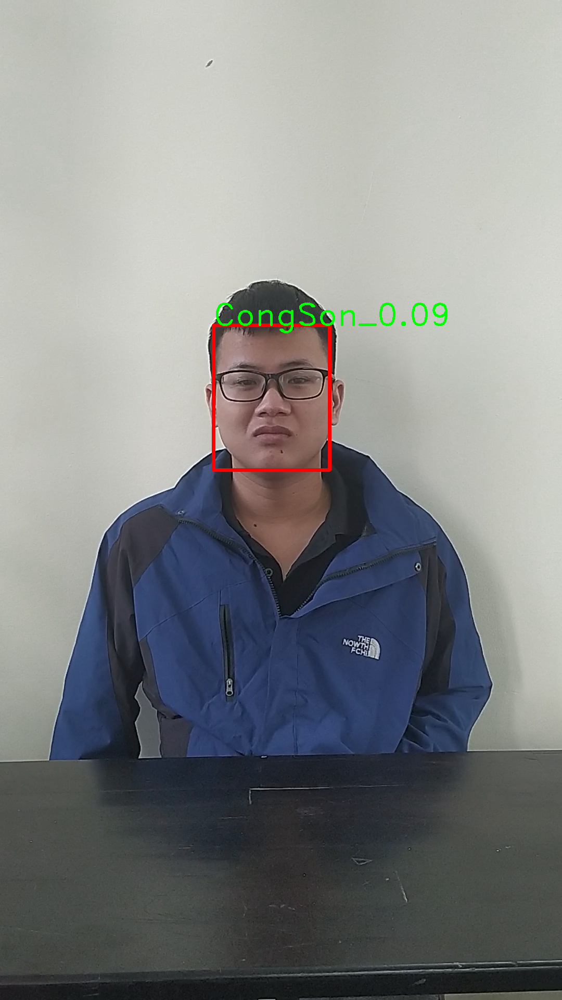

tensor([15], device='cuda:0')
tensor([0.0287], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.02869134618777025


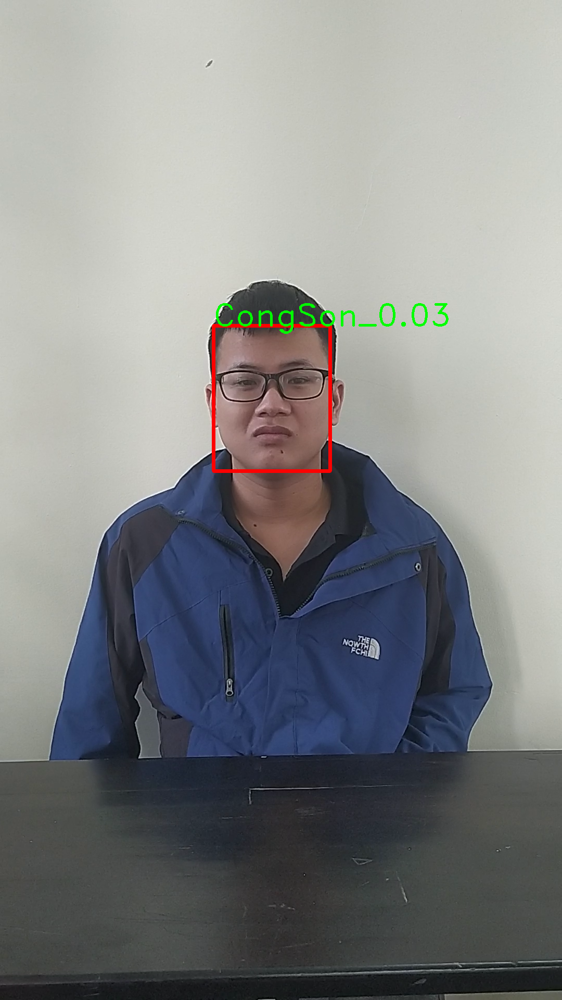

tensor([15], device='cuda:0')
tensor([0.3879], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.38790739154137555


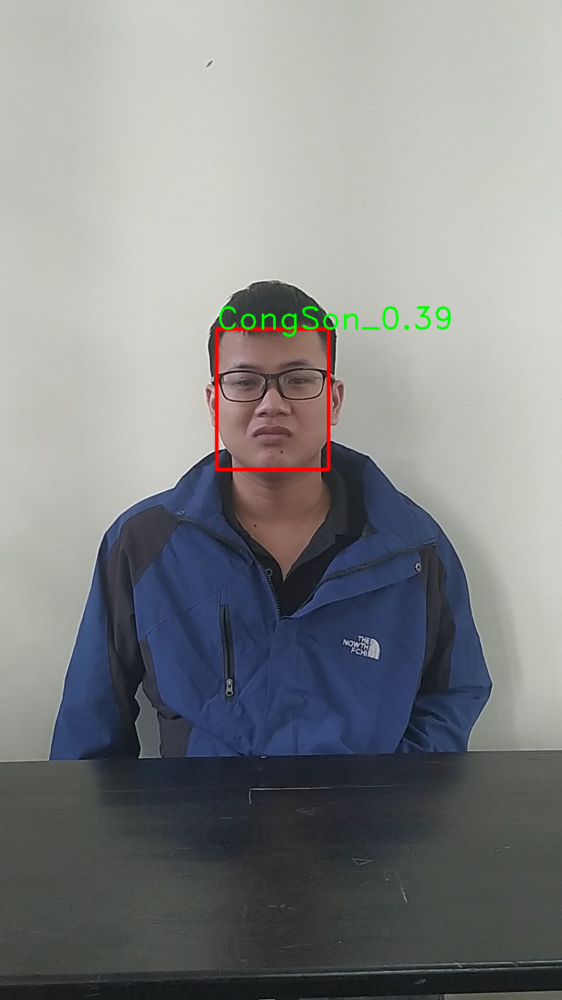

tensor([15], device='cuda:0')
tensor([0.1285], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.12851455721829552


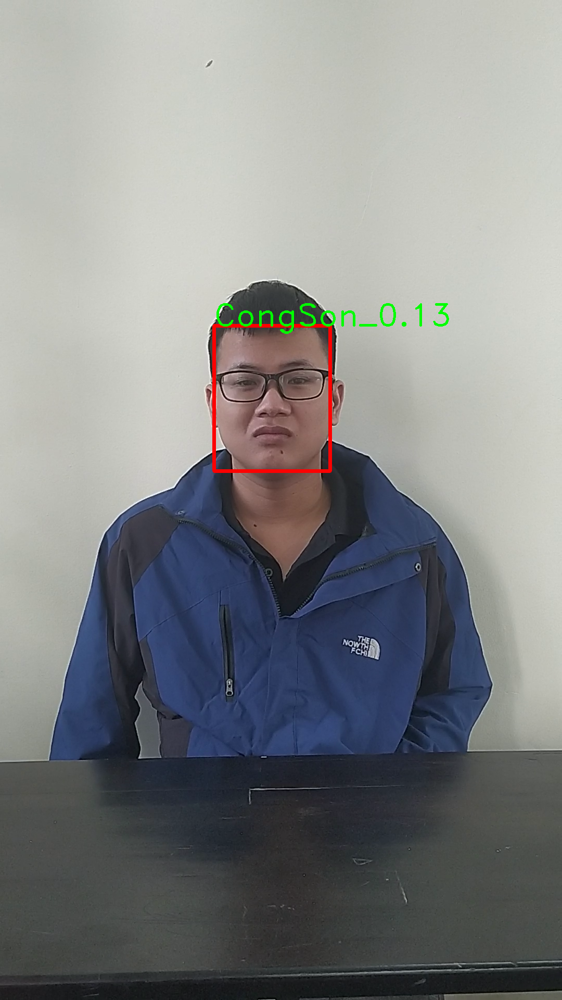

tensor([15], device='cuda:0')
tensor([0.0875], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.08750403424073738


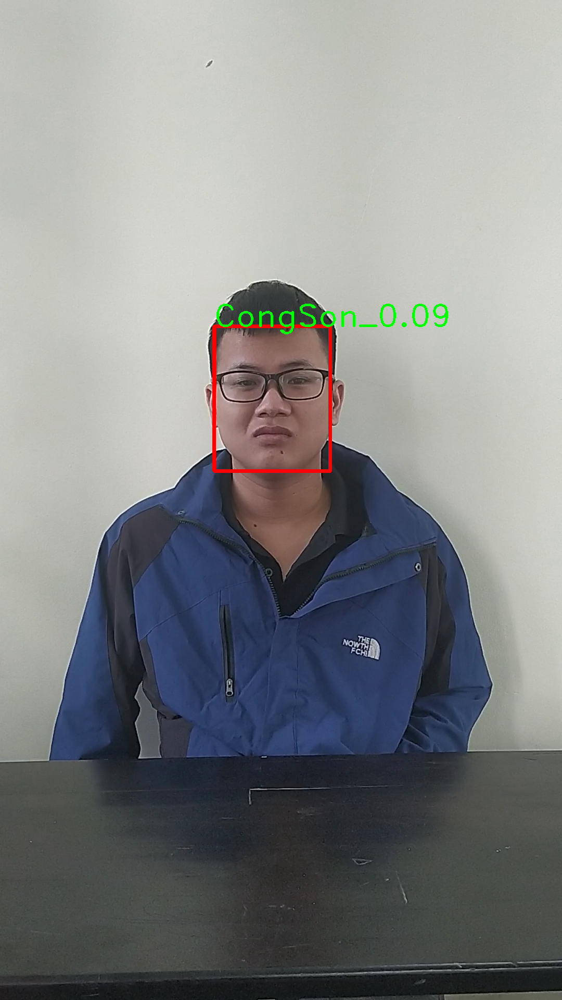

tensor([15], device='cuda:0')
tensor([0.4083], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.40833805314832716


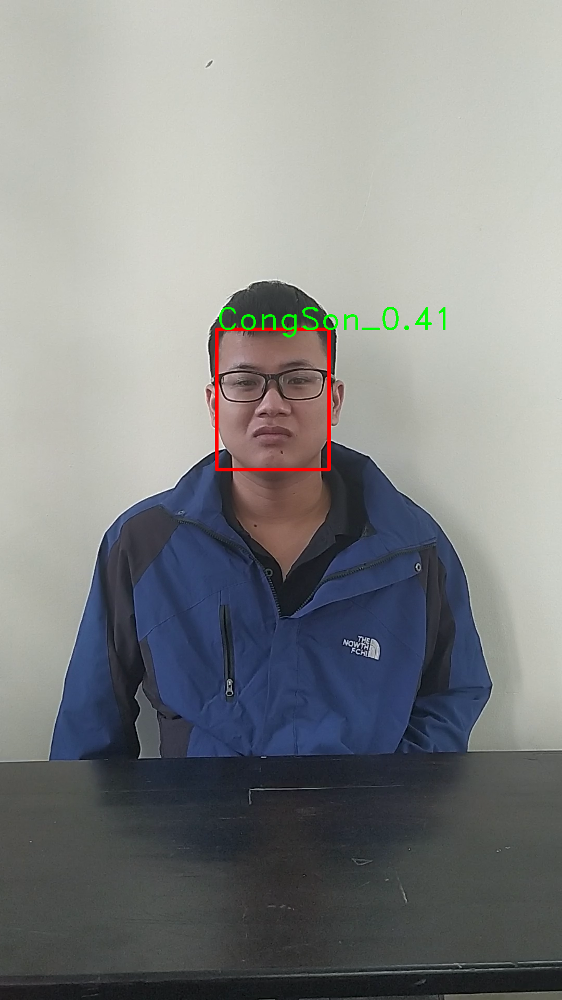

tensor([15], device='cuda:0')
tensor([0.0452], device='cuda:0', grad_fn=<MulBackward0>) CongSon
0.045200195586403424


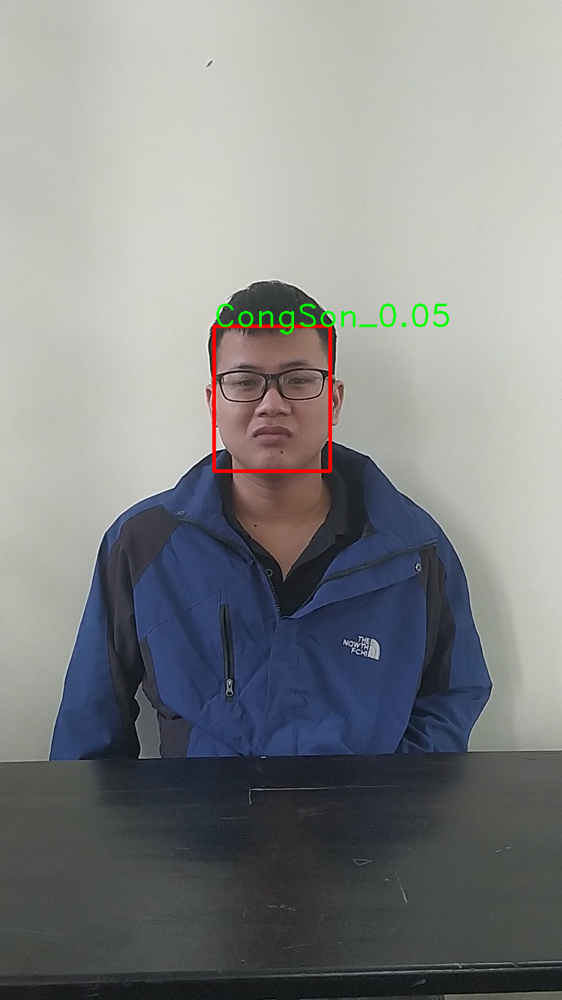

KeyboardInterrupt: ignored

In [210]:
#Khanh Duong OK
#Cong Son OK
from google.colab.patches import cv2_imshow
import cv2
from IPython.display import display, Image as IPImage
import numpy as np
import dlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

power = pow(10, 6)
video_url = '/content/drive/MyDrive/Facenet_khaiphadulieu/dataset/Nam_Video/CongSon.mp4'
v_cap = cv2.VideoCapture(video_url)

while True:
  success, frame = v_cap.read()
  if not success:
    break
  #boxes, probs = mtcnn.detect(frame)
  # if boxes is not None:
  #     faces = mtcnn(frame)
  #     for face in faces:
  #       print(face.shape)
  #       face_np = face.permute(1, 2, 0).detach().cpu().numpy()
  #       print(face_np.shape)
  #       cv2_imshow(face_np)
  #       idx, score = inference(model, face_np, embeddings, power)
  #       print(idx, score)
  boxes, _ = mtcnn.detect(frame)
  for box in boxes:
    bbox = list(map(int,box.tolist()))
    face = extract_face(bbox, frame)
    idx, score = inference(model, face, embeddings, power)
    if idx != -1:
        frame = cv2.rectangle(frame, (bbox[0],bbox[1]), (bbox[2],bbox[3]), (0,0,255), 6)
        score = torch.Tensor.cpu(score[0]).detach().numpy()*power
        print(score)
        frame = cv2.putText(frame, names[idx] + '_{:.2f}'.format(float(score)), (bbox[0],bbox[1]), cv2.FONT_HERSHEY_DUPLEX, 2, (0,255,0), 2, cv2.LINE_8)
    else:
        frame = cv2.rectangle(frame, (bbox[0],bbox[1]), (bbox[2],bbox[3]), (0,0,255), 6)
        frame = cv2.putText(frame,'Unknown', (bbox[0],bbox[1]), cv2.FONT_HERSHEY_DUPLEX, 2, (0,255,0), 2, cv2.LINE_8)
    cv2_imshow(frame)

v_cap.release()
cv2.destroyAllWindows()